In [1]:
#Importing all the libraries that is required to run this Object Detection API:

import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile
import pathlib
from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display

# This are the libraries which we need to import to use this Object Detection API given by Tensorflow(set the path of object_detection folder correctly):

from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

c:\python39\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
c:\python39\lib\site-packages\numpy\.libs\libopenblas.GK7GX5KEQ4F6UYO3P26ULGBQYHGQO7J4.gfortran-win_amd64.dll
c:\python39\lib\site-packages\numpy\.libs\libopenblas.NOIJJG62EMASZI6NYURL6JBKM4EVBGM7.gfortran-win_amd64.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


ModuleNotFoundError: No module named 'object_detection'

In [2]:
 
while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')

# We have created a fuction load_model To load the model and save it on the system:

def loading_model(model_name):
  base_url = 'http://download.tensorflow.org/models/object_detection/'
  model_file = model_name + '.tar.gz'
  model_dir = tf.keras.utils.get_file(
    fname=model_name, 
    origin=base_url + model_file,
    untar=True)
 
  model_dir = pathlib.Path(model_dir)/"saved_model"
 
  model = tf.saved_model.load(str(model_dir))
 
  return model


In [3]:
# set the path of label file and Load label map data (for plotting):
labels_path = 'models/research/object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(labels_path , use_display_name=True)


In [4]:
###To download Labels Manually:
# def downloading_labels(filename):
#     base_url = 'https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/data/'
#     label_dir = tf.keras.utils.get_file(fname=filename,
#                                         origin=base_url + filename,
#                                         untar=False)
#     label_dir = pathlib.Path(label_dir)
#     return str(label_dir)

# label_filename = 'mscoco_label_map.pbtxt'
# labels_path= download_labels(label_filename)

# category_index = label_map_util.create_category_index_from_labelmap(labels_path, use_display_name=True)


In [5]:
# In this we are loading the model(you can choose model according to your system , the name of available models is shown above):

model = 'ssd_inception_v2_coco_2017_11_17'
model = load_model(model)


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


In [6]:
# Now we will run the model for single image:

def run_model_for_single_image(model,image):
    #converting image to array:
    image = np.asarray(image)
    
    #converting the image into tensor(as input should be a tensor):
    tensor_image = tf.convert_to_tensor(image)
    
   
    tensor_image = tensor_image[tf.newaxis,...]
    
    # Run model:
    model_fn = model.signatures['serving_default']
    result_dict = model_fn(tensor_image)
    
    #detecting
    detections = int(result_dict.pop('num_detections'))
    result_dict = {key:value[0,:detections].numpy() for key,value in result_dict.items()}
    result_dict['num_detections'] = detections
    
    # convert detection_classes to int
    result_dict['detection_classes'] = result_dict['detection_classes'].astype(np.int64)
    
    
    if 'detection_masks' in result_dict:
        # we have to set that mask according to the size of image:
        modified_detection_masks = utils_ops.reframe_box_masks_to_image_masks(
              result_dict['detection_masks'], result_dict['detection_boxes'],
               image.shape[0], image.shape[1])
        modified_detection_masks = tf.cast(modified_detection_masks > 0.5,tf.uint8)
        
        result_dict['modified_detection_masks'] = modified_detection_masks.numpy()
        
    return result_dict



In [7]:
# now we will create a function to show this model:
def model_show(model, image_path):
    image = np.array(Image.open(image_path))
    
    # Actual detection:
    result_dict = run_model_for_single_image(model,image)
    
    # Visualize the Detection:
    vis_util.visualize_boxes_and_labels_on_image_array(
      image,
      result_dict['detection_boxes'],
      result_dict['detection_classes'],
      result_dict['detection_scores'],
      category_index,
      instance_masks=result_dict.get('modified_detection_masks', None),
      use_normalized_coordinates=True,
      line_thickness=8)
    
    display(Image.fromarray(image))

In [8]:
# Set path to test image directory: 

test_path= pathlib.Path('models/research/object_detection/test_images')
test_path= sorted(list(test_path.glob("*.jpg")))

models\research\object_detection\test_images\image1.jpg


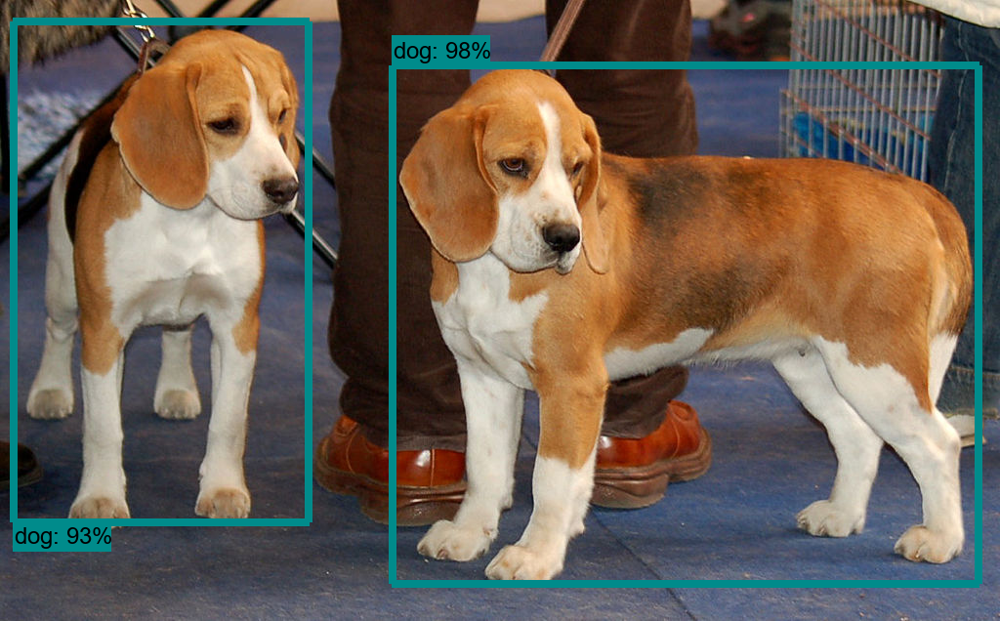

models\research\object_detection\test_images\image2.jpg


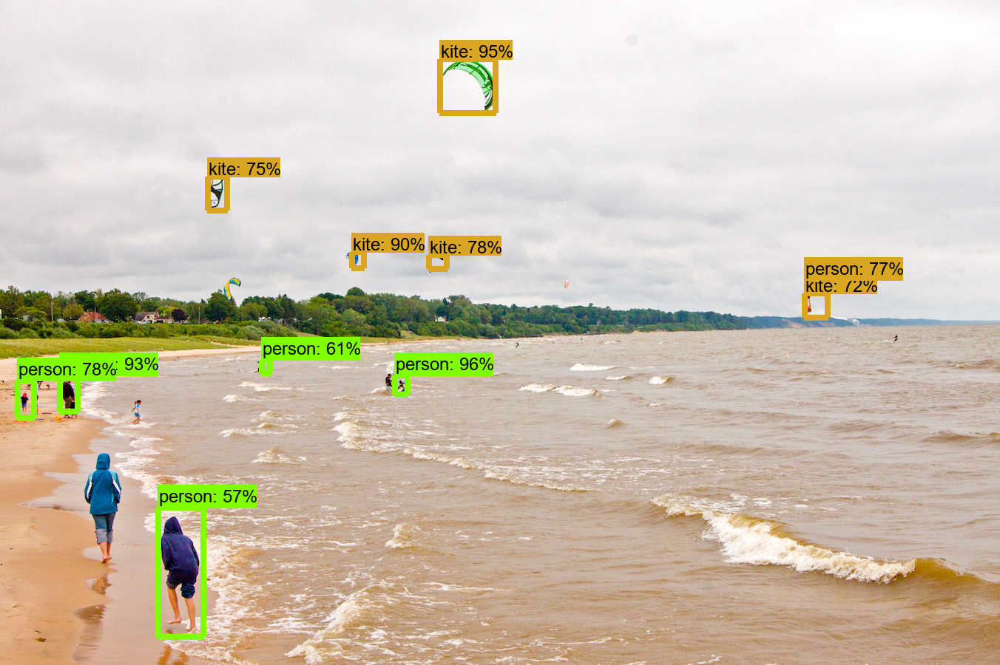

models\research\object_detection\test_images\image3.jpg


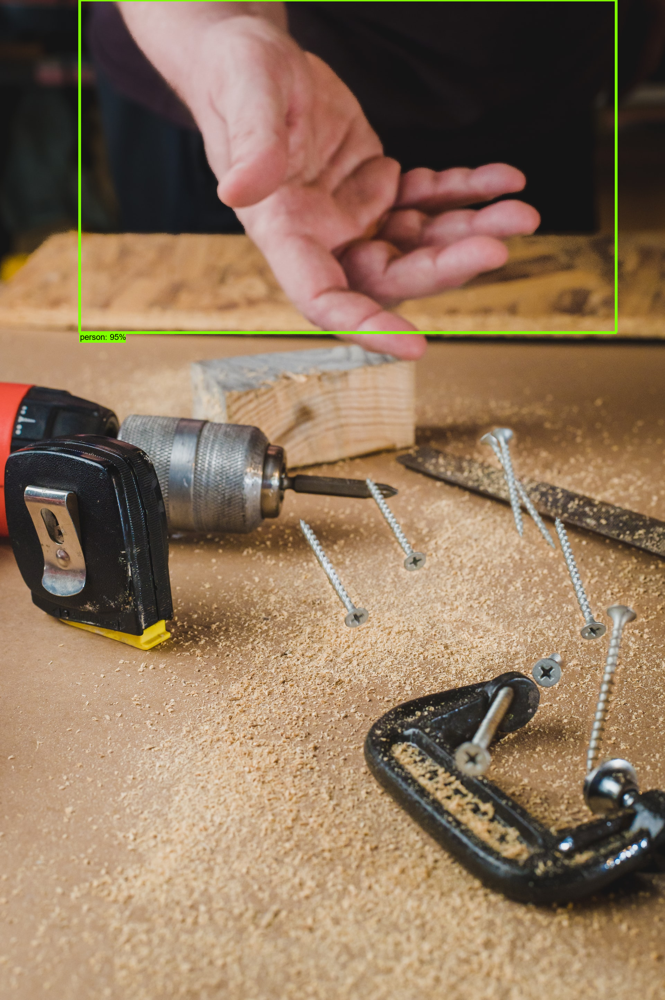

models\research\object_detection\test_images\image4.JPG


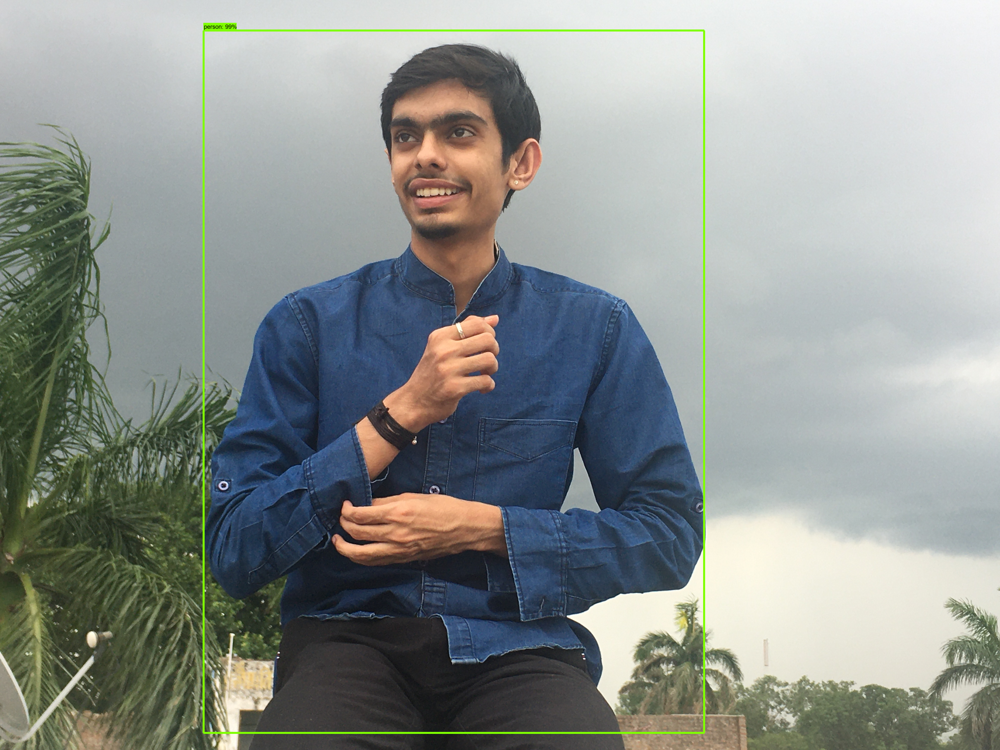

models\research\object_detection\test_images\image5.jpg


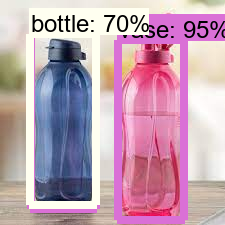

models\research\object_detection\test_images\image6.jpg


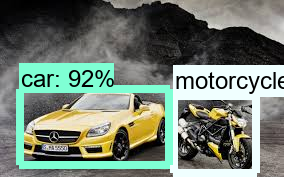

In [9]:
# run model for this test images one by one:

for image_path in test_path:
    print(image_path)
    model_show(model, image_path)